In [ ]:
!cd drive/MyDrive/Colab_Notebooks/TRD-Data/

/bin/bash: line 1: cd: drive/MyDrive/Colab_Notebooks/TRD-Data/: No such file or directory


In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!git clone https://github.com/AlexisManriquez/TRD-Data.git

Cloning into 'TRD-Data'...
remote: Enumerating objects: 69, done.
remote: Counting objects: 100% (5/5), done.
remote: Compressing objects: 100% (5/5), done.
remote: Total 69 (delta 1), reused 0 (delta 0), pack-reused 64
Receiving objects: 100% (69/69), 7.37 MiB | 17.98 MiB/s, done.
Resolving deltas: 100% (3/3), done.


In [17]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
month ="01"
year = 2024
day = "03"
day_prev = "03"
# Load the CSV file
#df = pd.read_csv(f'/content/drive/MyDrive/Colab_Notebooks/TRD-Data/BTCUSDT_DATA/BTCUSDT-15m-{year}-{month}.csv')
#df = pd.read_csv(f'./BTCUSDT_DATA/BTCUSDT-15m-{year}-{month}.csv')
df = pd.read_csv(f'./BTCUSDT-trades/BTCUSDT-trades-{year}-{month}-{day}.csv')
df_prev = pd.read_csv(f'./BTCUSDT-trades/BTCUSDT-trades-{year}-{month}-{day_prev}.csv')
#df = pd.read_csv('./BTCUSDT_DATA/BTCUSDT-15m-2019-11.csv')
# Convert Unix time to datetime
df['time'] = pd.to_datetime(df['time'], unit='ms')
df_prev['time'] = pd.to_datetime(df_prev['time'], unit='ms')
#set timezone to est
#df['open_time'] = df['open_time'].dt.tz_localize('UTC').dt.tz_convert('US/Eastern')
# Set the date as the index
df = df.set_index('time')

#df.drop(['close_time',  'quote_volume', 'count', 'taker_buy_base_volume', 'taker_buy_quote_volume'], axis=1, inplace=True)
#display entire dataframe
pd.set_option('display.max_rows', None)
df


,id,price,qty,quote_qty,is_buyer_maker
time,,,,,
2024-01-03 00:00:01.267,27256679,44931.83,0.00152,68.296382,True
2024-01-03 00:00:09.012,27256680,44952.99,0.00044,19.779316,False
2024-01-03 00:00:09.341,27256681,44953.00,0.23091,10380.097230,False
2024-01-03 00:00:14.012,27256682,44945.85,0.00800,359.566800,True
2024-01-03 00:00:14.012,27256683,44945.84,0.00286,128.545102,True
2024-01-03 00:00:21.294,27256684,44967.57,0.00015,6.745135,False
2024-01-03 00:00:54.246,27256685,44975.70,0.00163,73.310391,False
2024-01-03 00:00:54.246,27256686,44977.90,0.00072,32.384088,False
2024-01-03 00:00:54.246,27256687,44980.00,0.00209,94.008200,False


In [4]:

data= df[['time', 'quote_qty', 'price']] 
data_prev = df_prev[['time', 'quote_qty', 'price']]
#sort largest quote_qty to smallest past 19:00
#data_start = data_start[data_start['time'] <= '2024-01-04 9:00:00']
data_prev = data_prev[data_prev['time'] >= '2024-01-03 19:00:00']
#combine data_start and data_prev
#data = pd.concat([data_start, data_prev])
data = data.sort_values(by='price', ascending=False)
data
#1.53519

,time,quote_qty,price
29245,2024-01-01 23:52:39.806,3309.240000,44000.00
29237,2024-01-01 23:52:39.806,1475.320000,44000.00
29394,2024-01-01 23:56:37.322,2640.000000,44000.00
29379,2024-01-01 23:55:22.947,9.680000,44000.00
29414,2024-01-01 23:57:02.838,2.640000,44000.00
...,...,...,...
7754,2024-01-01 05:56:23.264,42.213240,42213.24
7751,2024-01-01 05:56:15.667,5.909702,42212.16
7780,2024-01-01 05:57:02.390,12.663600,42212.00
7752,2024-01-01 05:56:15.667,20645.889200,42212.00


In [18]:
import pandas as pd
import numpy as np
from scipy import stats, signal
import plotly.express as px
import plotly.graph_objects as go

px.histogram(df, x='quote_qty', y='price', nbins=24, orientation='h').show()

In [22]:
import time
def scenario_one(open_price, value_area_high, value_area_low, current_price, volume_1, volume_2):
    if open_price > value_area_high and current_price >= value_area_high:
        return "Scenario One: Long"
    elif current_price < value_area_high and current_price > value_area_low and volume_1 > volume_2:
        return "scenario One: Long "
    else:
        return "Scenario One: None "

def scenario_two(open_price, value_area_high, current_price, volume):
    if open_price > value_area_high and current_price <= value_area_high:
        return "Scenario Two: Short"
    else:
        return "Scenario Two: None"
def scenario_three(open_price, value_area_low, current_price, volume):
    if open_price < value_area_low and current_price >= value_area_low:
        return "Scenario Three: Long"
    else:
        return "Scenario Three: None"
def scenario_four(open_price, value_area_high, value_area_low, current_price, volume_1, volume_2):
    if open_price < value_area_low and current_price <= value_area_low:
        return "Scenario Four: Short"
    elif open_price < value_area_high and current_price > value_area_low and volume_1 > volume_2:
        return "Scenario Four: Short"
    else:
        return "Scenario Four: None"
def scenario_five(open_price, value_area_high, value_area_low, current_price):

    if open_price > value_area_low and open_price < value_area_high  and current_price > value_area_low and current_price < value_area_high:
        return "Scenario Five: Neutral"
    else:
        return "Scenario Five: None"
def simulate_short_leverage(initial_balance, leverage, buy_position, sell_price, short_long):
    """
    Simulates short selling with leverage.

    Args:
        initial_balance (float): Initial account balance.
        leverage (float): Leverage factor (e.g., 2 for 2x leverage).
        price_change_pct (float): Percentage change in asset price (negative for price decrease).

    Returns:
        float: Final account balance after shorting.
    """
    # Calculate the effective leverage
    leveraged = leverage * initial_balance

    # Calculate the new balance after price change
    if short_long == "Short":
        PnL_short = (buy_position - sell_price)*(leveraged/buy_position)
        print(PnL_short)
        new_balance = initial_balance + PnL_short
    elif short_long == "Long":
        PnL_long = (sell_price - buy_position)*(leveraged/buy_position)
        new_balance = initial_balance + PnL_long
    return new_balance
#extract time and volume columns
#data = df[['open_time', 'volume']]
initial_balance = 100  # Initial account balance in USD
leverage = 5         # Leverage ratio (10x)
data.sort_values(by="quote_qty", ascending=False, inplace=True)
    # Calculate total traded volume
total_volume = data["quote_qty"].sum()

    # Determine 70% of total volume
value_area_target = total_volume * 0.7

    # Initialize Value Area with POC
poc = data.iloc[0]
value_area = [poc]
current_volume = poc["quote_qty"]

    # Iterate above and below POC
poc_index = data.index.get_loc(poc.name)
above_index, below_index = poc_index + 1, poc_index - 1

while current_volume < value_area_target:
        if above_index < len(data):
            above_row = data.iloc[above_index]
        else:
            above_row = None

        if below_index >= 0:
            below_row = data.iloc[below_index]
        else:
            below_row = None

        if above_row is None and below_row is None:
            break

        if not below_row or (above_row and above_row["quote_qty"] > below_row["quote_qty"]):
            value_area.append(above_row)
            current_volume += above_row["quote_qty"]
            above_index += 1
        else:
            value_area.append(below_row)
            current_volume += below_row["quote_qty"]
            below_index -= 1

    # Determine VAH and VAL
vah = max(value_area, key=lambda x: x["time"])
val = min(value_area, key=lambda x: x["time"])
             



In [ ]:
if 8238.69 < 8228.54:
    print("yes")

2024-01-02 09:00:00


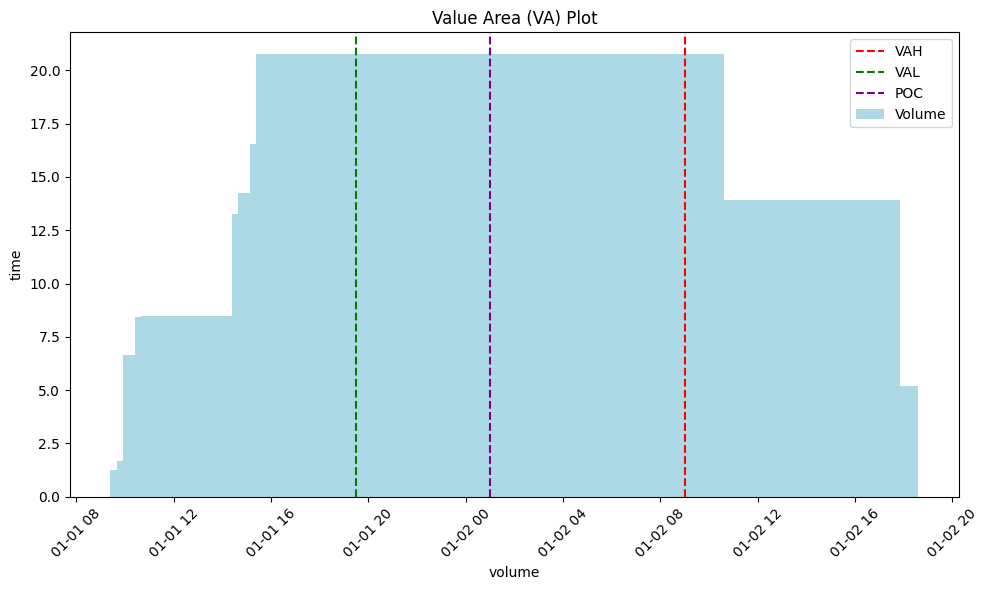

In [20]:
import pandas as pd
import matplotlib.pyplot as plt
# Calculate VAH and VAL (replace with your actual values)
vah_time = vah['time']
val_time = val['time']
poc_time = poc['time']
print(vah_time)
# Create a bar chart
plt.figure(figsize=(10, 6))
plt.bar(data["open_time"], data["volume"], color="lightblue", label="Volume")
plt.axvline(x=vah_time, color="red", linestyle="--", label="VAH")
plt.axvline(x=val_time, color="green", linestyle="--", label="VAL")
plt.axvline(x=poc_time, color="purple", linestyle="--", label="POC")  # Add POC line

plt.xlabel("volume")
plt.ylabel("time")
plt.title("Value Area (VA) Plot")
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()

# Show or save the plot
plt.show()


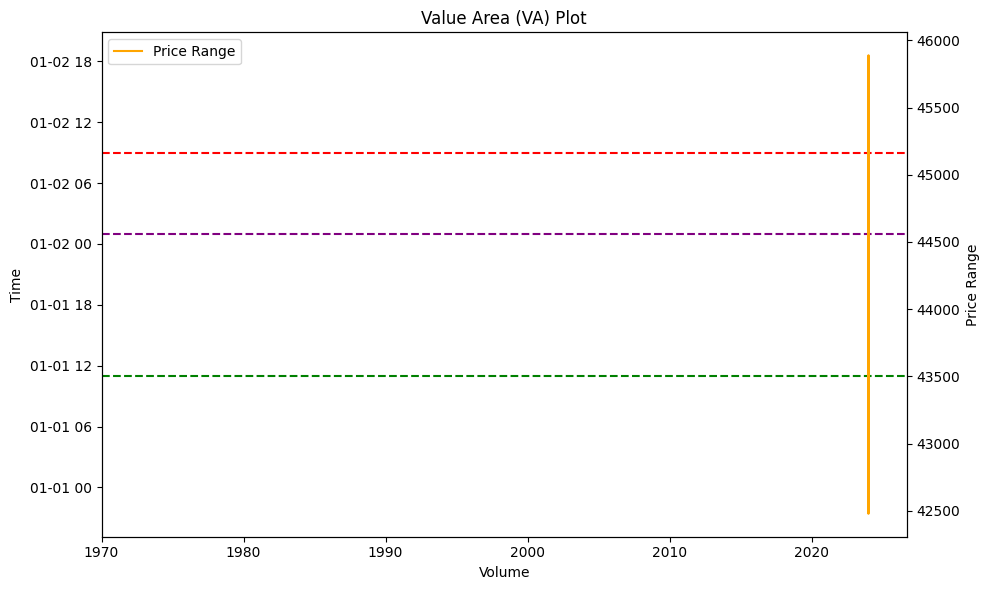

In [8]:
import pandas as pd
import matplotlib.pyplot as plt

# Calculate VAH and VAL (replace with your actual values)
vah_time = vah['open_time']
val_time = val['open_time']
poc_time = poc['open_time']

# Create a bar chart
fig, ax1 = plt.subplots(figsize=(10, 6))

# Plot the volume on the primary y-axis
ax1.barh(data["open_time"], data["volume"], color="lightblue", label="Volume")
ax1.set_xlabel("Volume")
ax1.set_ylabel("Time")

# Add horizontal lines for VAH, VAL, and POC
ax1.axhline(y=vah_time, color="red", linestyle="--", label="VAH")
ax1.axhline(y=val_time, color="green", linestyle="--", label="VAL")
ax1.axhline(y=poc_time, color="purple", linestyle="--", label="POC")

# Create a secondary y-axis for price range
ax2 = ax1.twinx()
# Replace 'price_range' with your actual price data
ax2.plot(data["open_time"], data["high"], color="orange", label="Price Range")
ax2.set_ylabel("Price Range")

# Set title and legend
plt.title("Value Area (VA) Plot")
plt.legend(loc="upper left")

# Rotate x-axis labels
plt.xticks(rotation=45)

# Adjust layout
plt.tight_layout()

# Show or save the plot
plt.show()


In [16]:
import pandas as pd
import plotly.graph_objs as go
import plotly.offline as pyo
from IPython.display import HTML
# Calculate VAH and VAL (replace with your actual values)
vah_time = vah['time']
val_time = val['time']
poc_time = poc['time']
# Create a bar chart
trace_volume = go.Bar(
    x=data["quote_qty"],
    y=data["time"],
    orientation='h',
    marker=dict(color="lightblue"),
    name="Volume"
)

# Create horizontal lines for VAH, VAL, and POC
trace_vah = go.Scatter(
    x=[0, 70000],
    y=[vah_time, vah_time],
    mode='lines',
    line=dict(color="red", dash="dash"),
    name="VAH"
)

trace_val = go.Scatter(
    x=[0, 70000],
    y=[val_time, val_time],
    mode='lines',
    line=dict(color="green", dash="dash"),
    name="VAL"
)

trace_poc = go.Scatter(
    x=[0, 70000],
    y=[poc_time, poc_time],
    mode='lines',
    line=dict(color="purple", dash="dash"),
    name="POC"
)


# Create a secondary y-axis for price range
trace_price_range = go.Scatter(
    x=(4, 4),
    y=(44657.7, 45399.8),
    mode='lines',
    line=dict(color="orange"),
    name="Price Range",
    yaxis="y2"
)

layout = go.Layout(
    title="Value Area (VA) Plot",
    xaxis=dict(title="Volume"),
    yaxis=dict(title="Time"),
    yaxis2=dict(title="Price Range", overlaying="y", side="right"),
    legend=dict(x=0, y=1),
    margin=dict(l=100, r=50, t=50, b=50),
)

fig = go.Figure(data=[trace_volume, trace_vah, trace_val, trace_poc, trace_price_range], layout=layout)

# Show the plot
pyo.iplot(fig)
#HTML(fig.to_html())